In [1]:
from IPython.display import YouTubeVideo

# Specify the YouTube video ID
video_id = 'xBi86fnau_s' ## https://www.youtube.com/watch?v=xBi86fnau_s 

# Embed the YouTube video in the notebook
YouTubeVideo(video_id)

Now we try to talk about the UI of Unity.  
First, we talk about button.

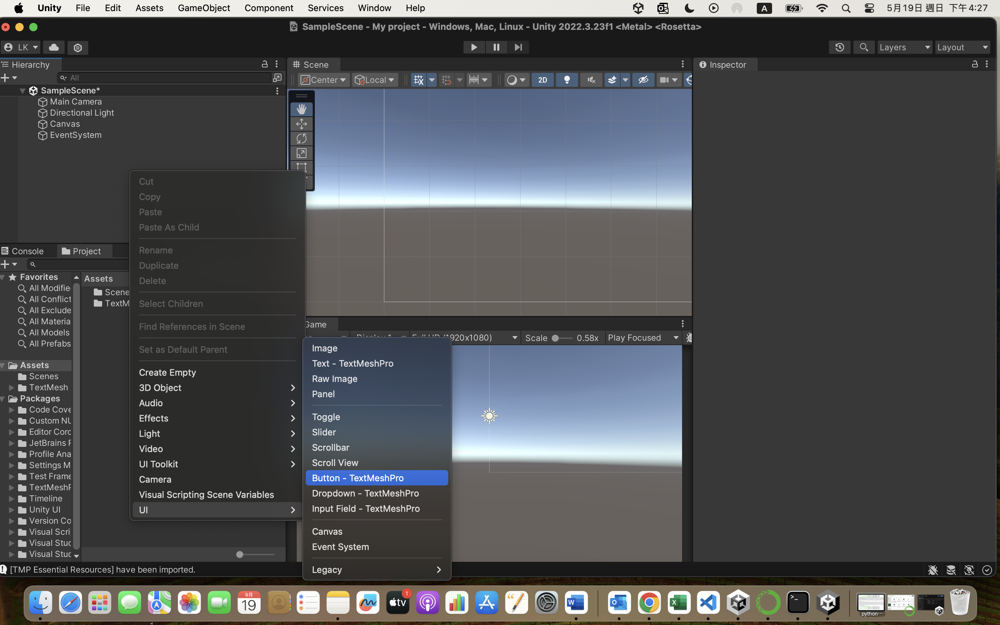

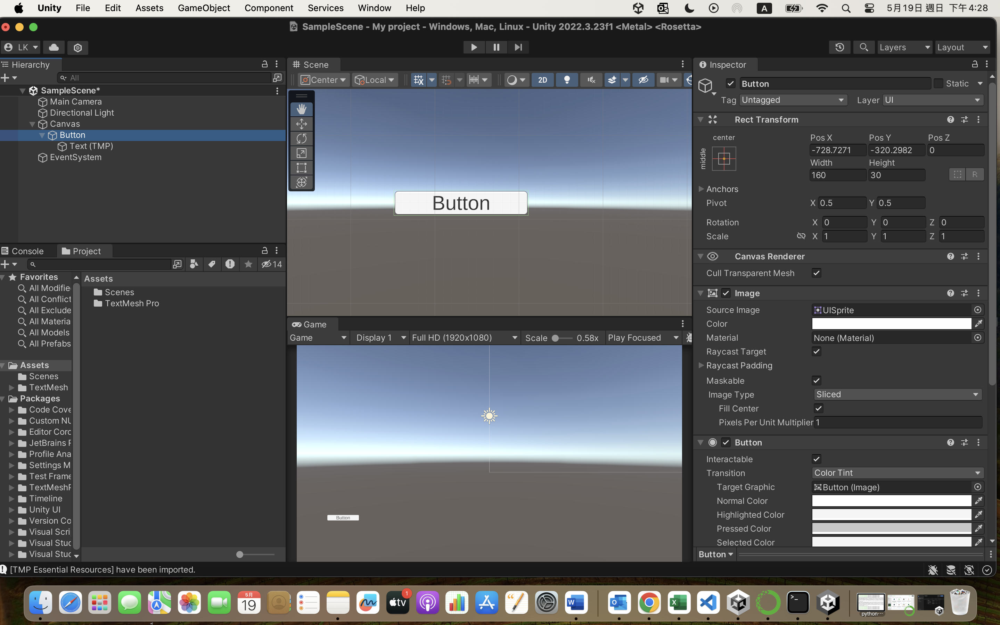

We can change the text of the button.

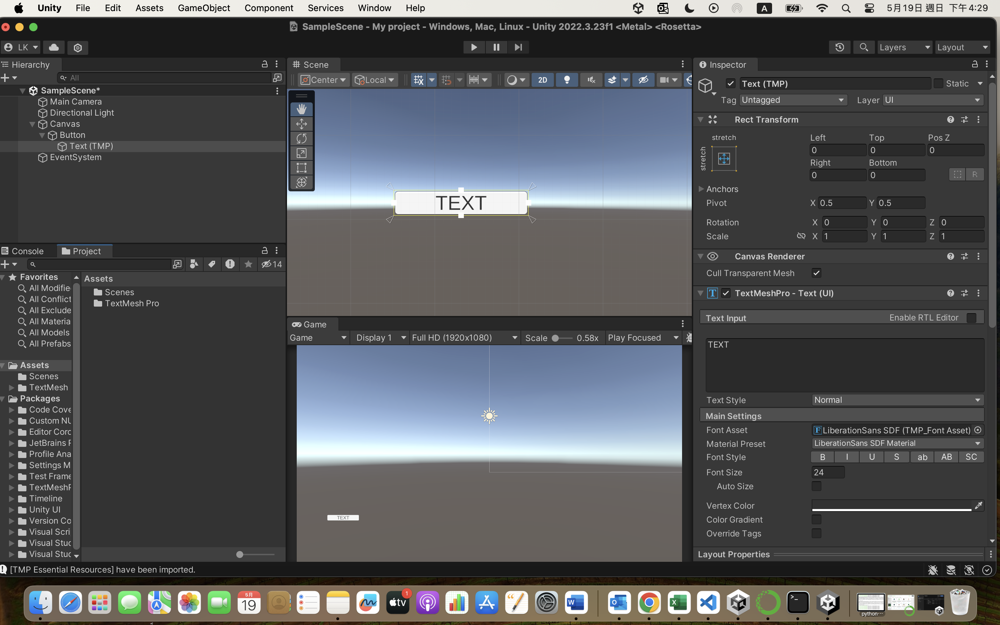

We can use the button to change scence.

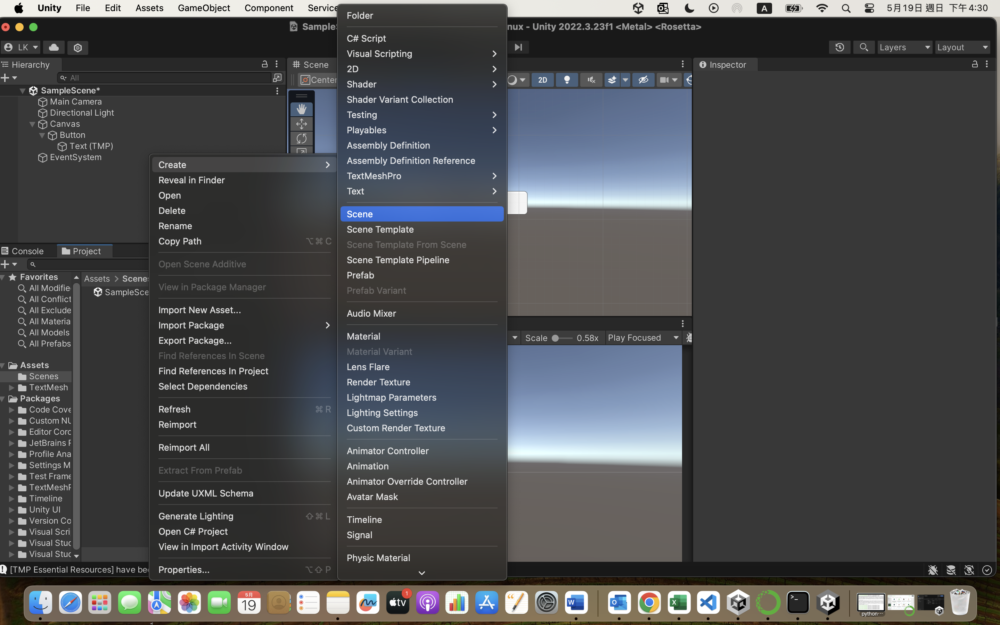

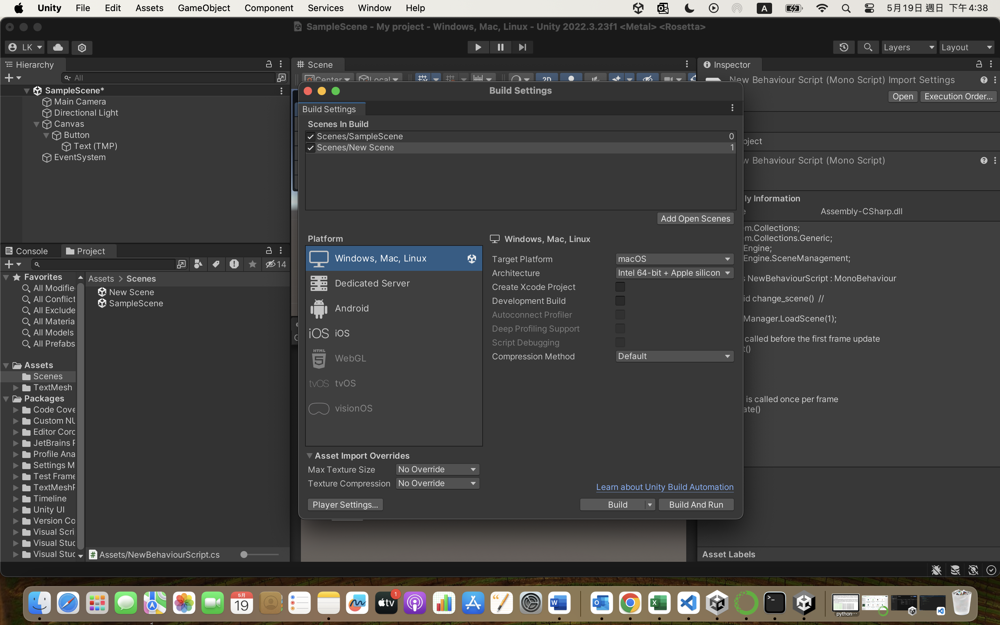

We create a C# script first.

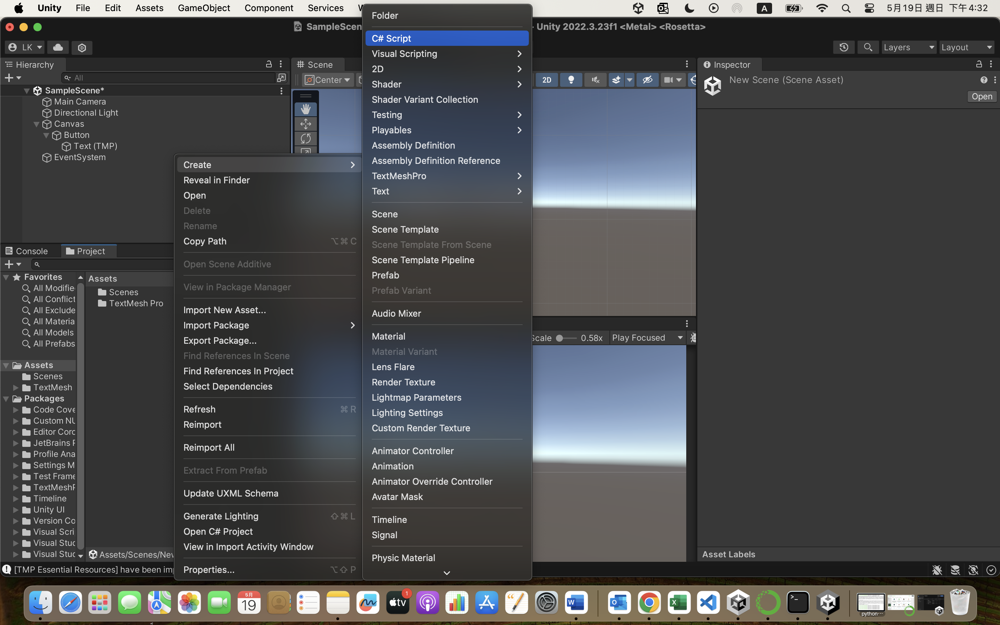

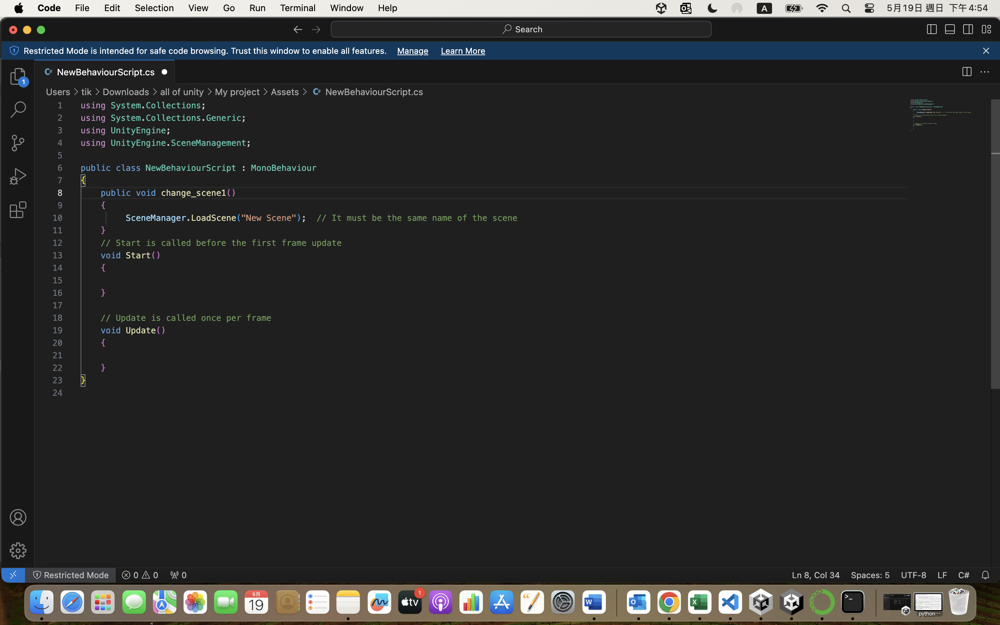

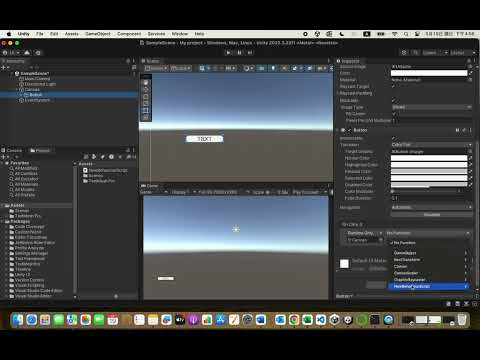

In [2]:
from IPython.display import YouTubeVideo

video_id1 = 'bjcNXLrOeuE' ## https://www.youtube.com/watch?v=bjcNXLrOeuE

YouTubeVideo(video_id1)

Also, we can use the similar method to achieve it.

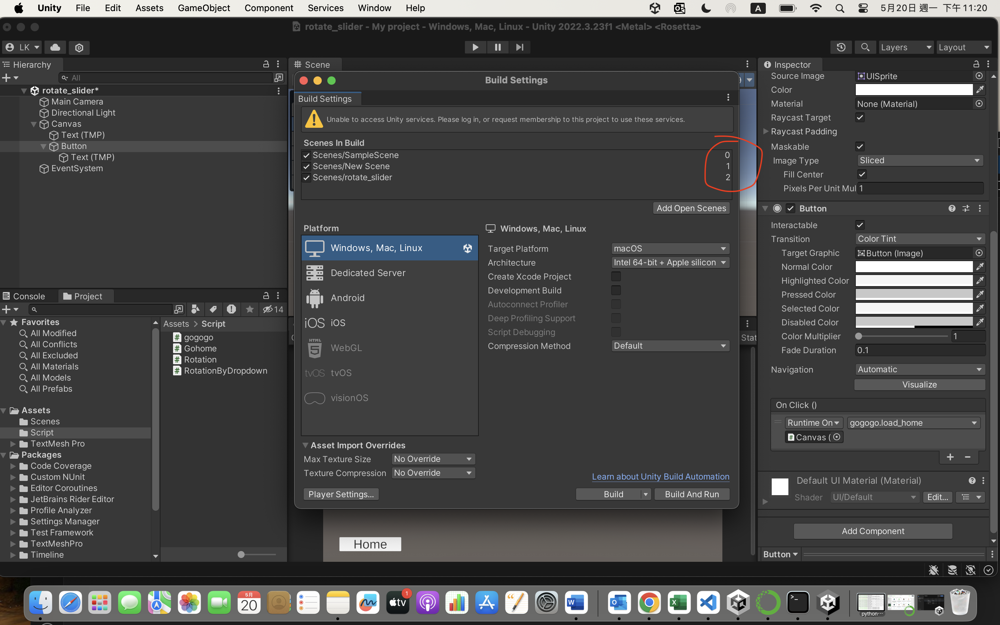

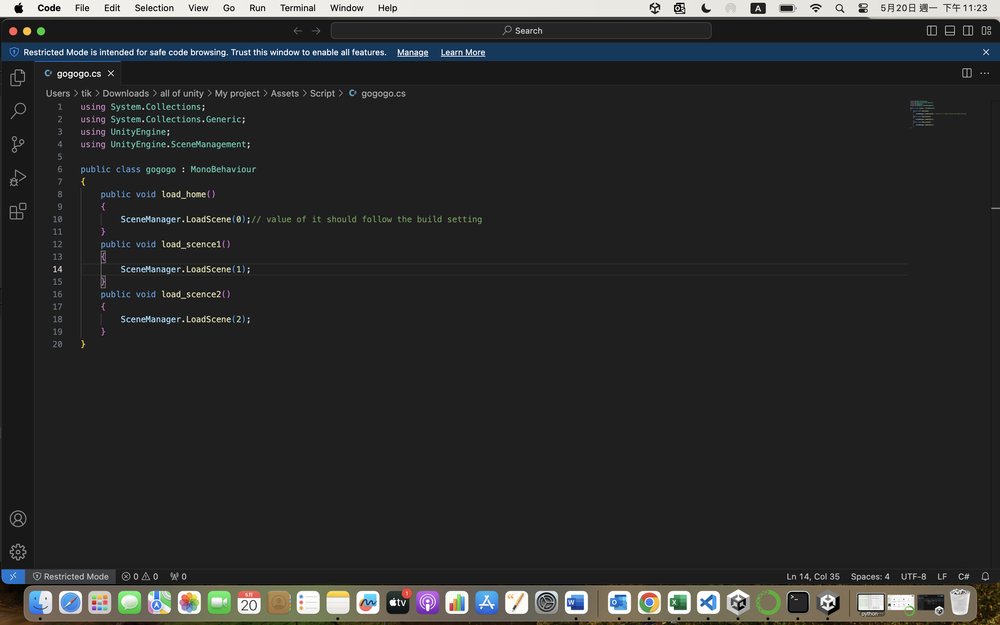

Then we can talk about the rotation of the object.

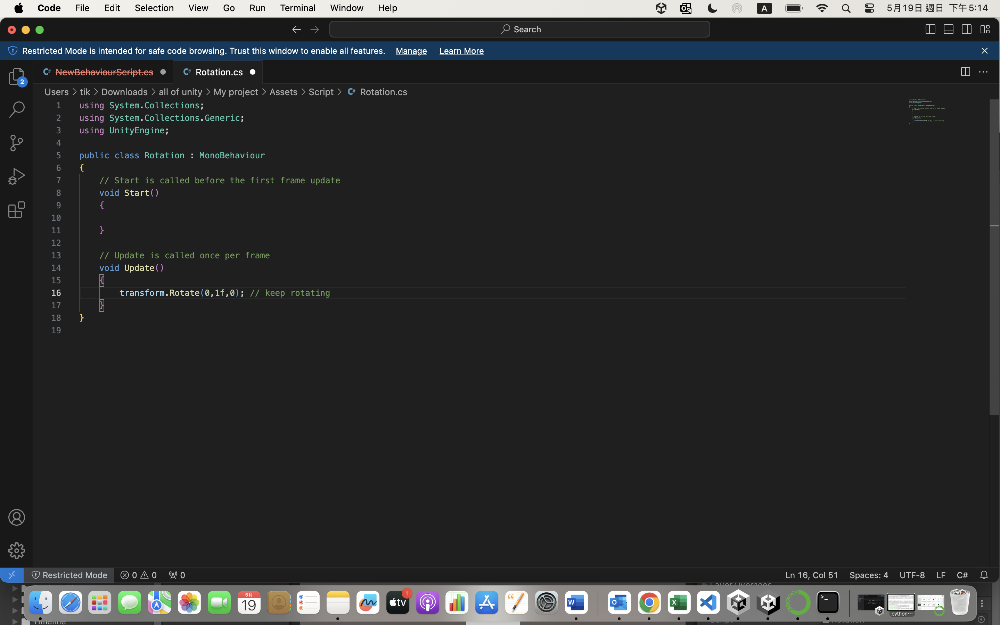

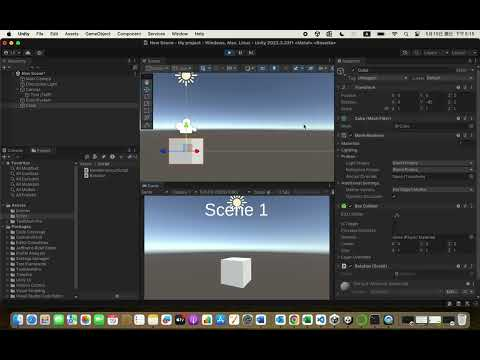

In [5]:
from IPython.display import YouTubeVideo

video_id1 = 'ElRFw_wmsTE' ## https://www.youtube.com/watch?v=ElRFw_wmsTE

YouTubeVideo(video_id1)

We can also use dropdown to control the game object

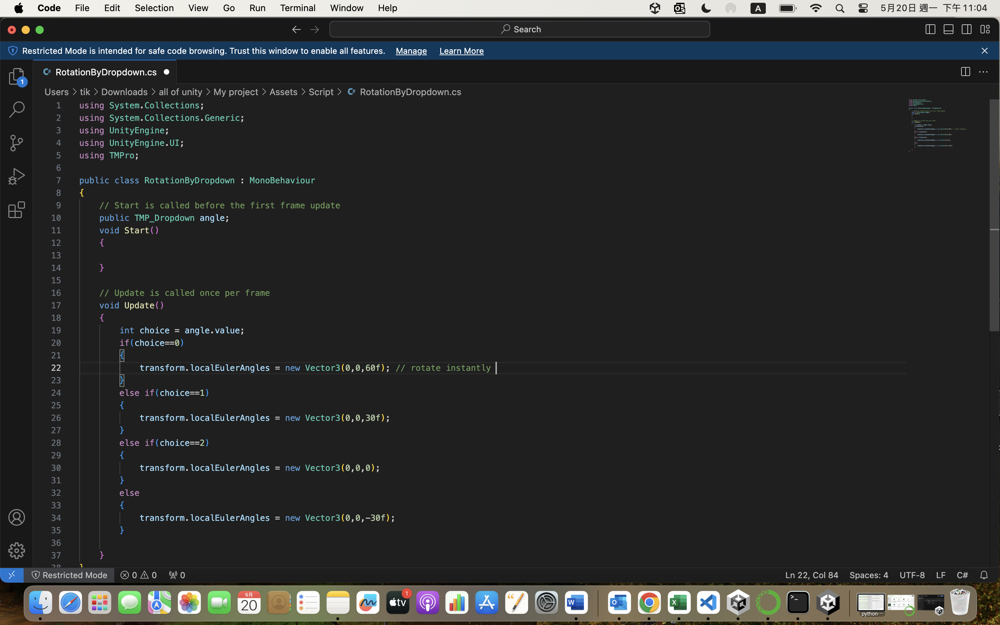

For this spgahetti code, we can improve it by using switch.

We can use slider to control the game object.

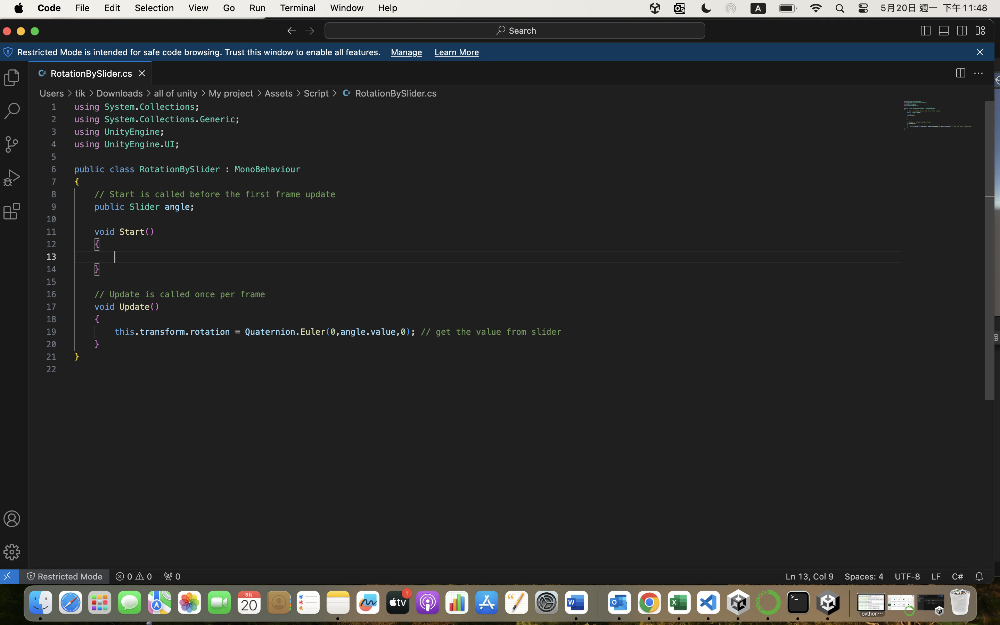

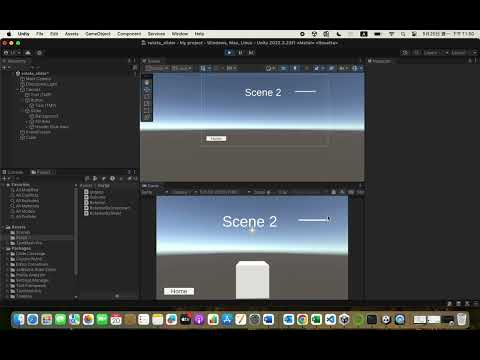

In [4]:
from IPython.display import YouTubeVideo

video_id = 'BjnFnik9B6E' ## https://www.youtube.com/watch?v=BjnFnik9B6E

YouTubeVideo(video_id)

We can rotate the object by moving other object. Just like looking other movement of object 

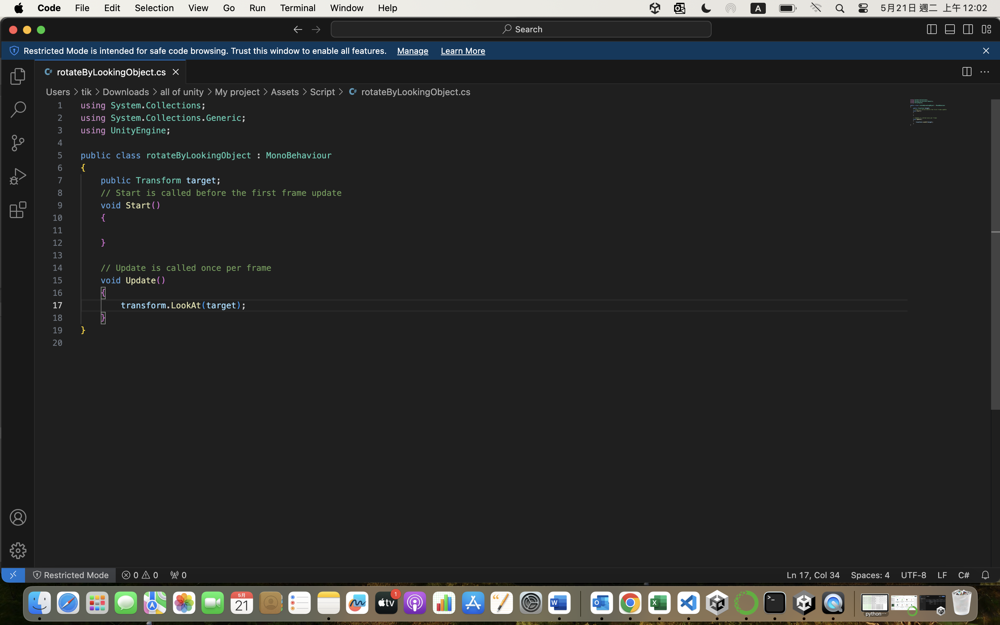

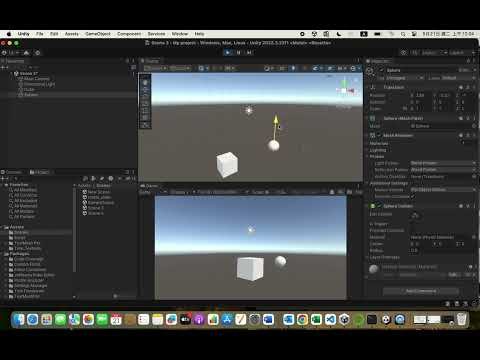

In [4]:
from IPython.display import YouTubeVideo

video_id = 'G6vQJKK1qqA' ## https://www.youtube.com/watch?v=G6vQJKK1qqA

YouTubeVideo(video_id)

For the next chapter, we talk about how to control the scale of the object.

We can also control the object scale by moving the slider.

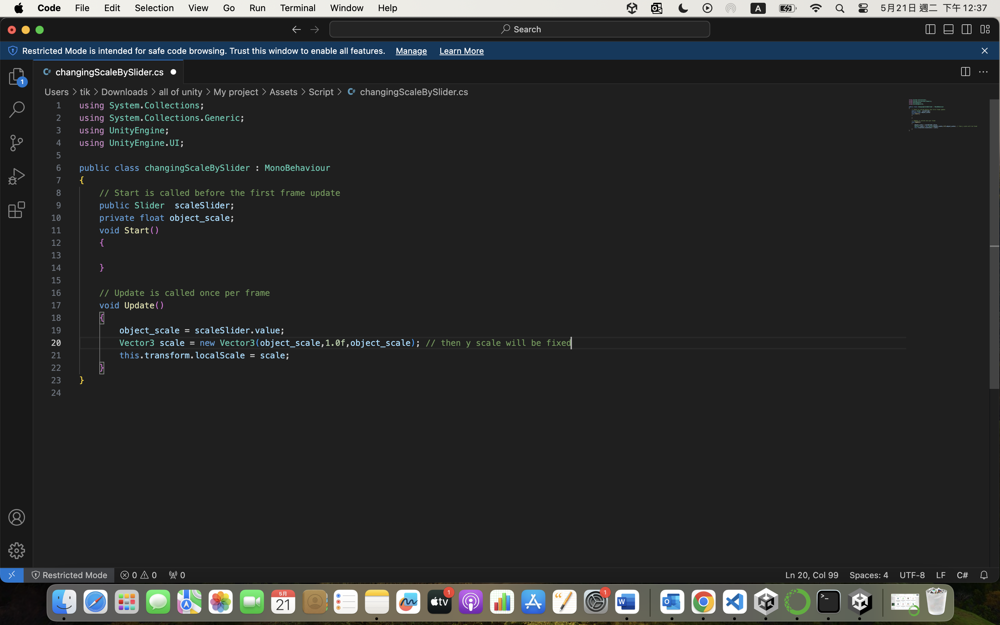

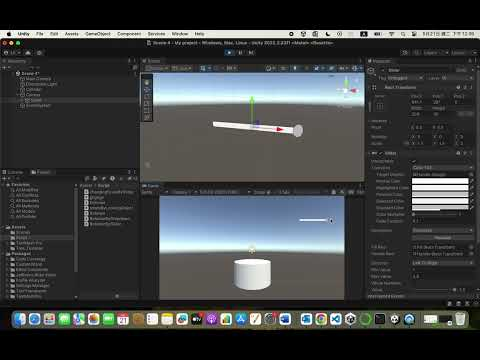

In [5]:
from IPython.display import YouTubeVideo

video_id = '0WCwBgdiu9k' ## https://www.youtube.com/watch?v=0WCwBgdiu9k

YouTubeVideo(video_id)

We can use some math function in unity. Here is the reference:  
https://docs.unity3d.com/ScriptReference/Mathf.html

We can use the script to show the text.

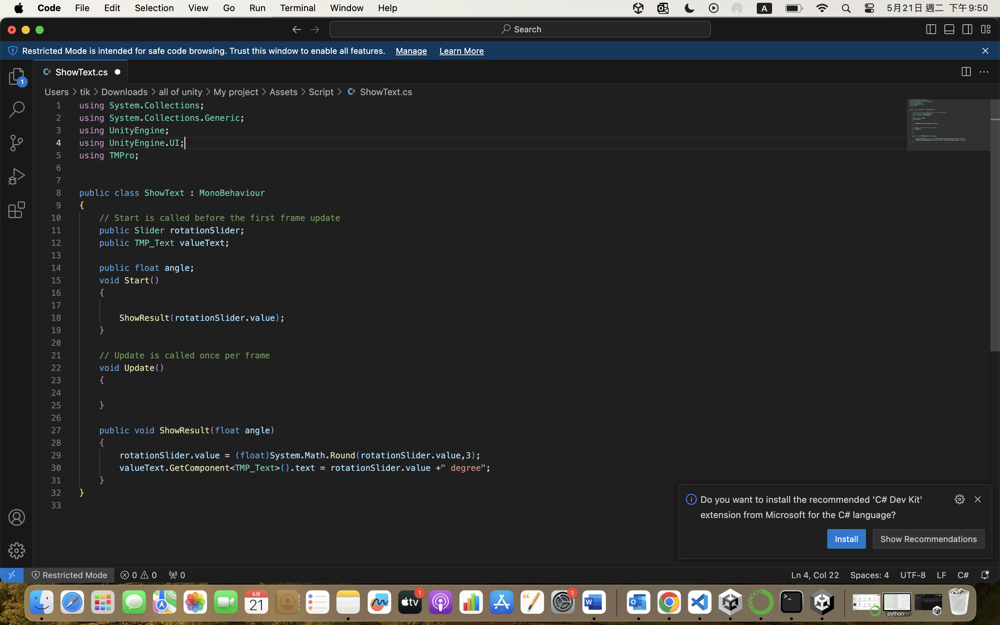

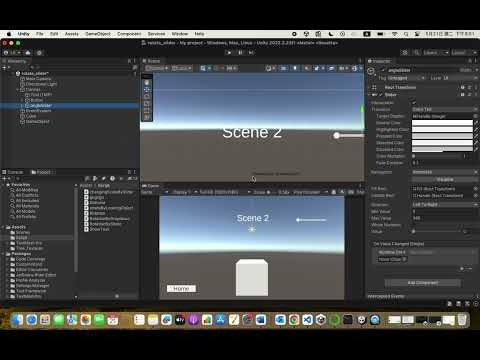

In [6]:
from IPython.display import YouTubeVideo

video_id = 'LPYJo9z5lYM' ## https://www.youtube.com/watch?v=LPYJo9z5lYM

YouTubeVideo(video_id)

We can change the location of the object by the script.  

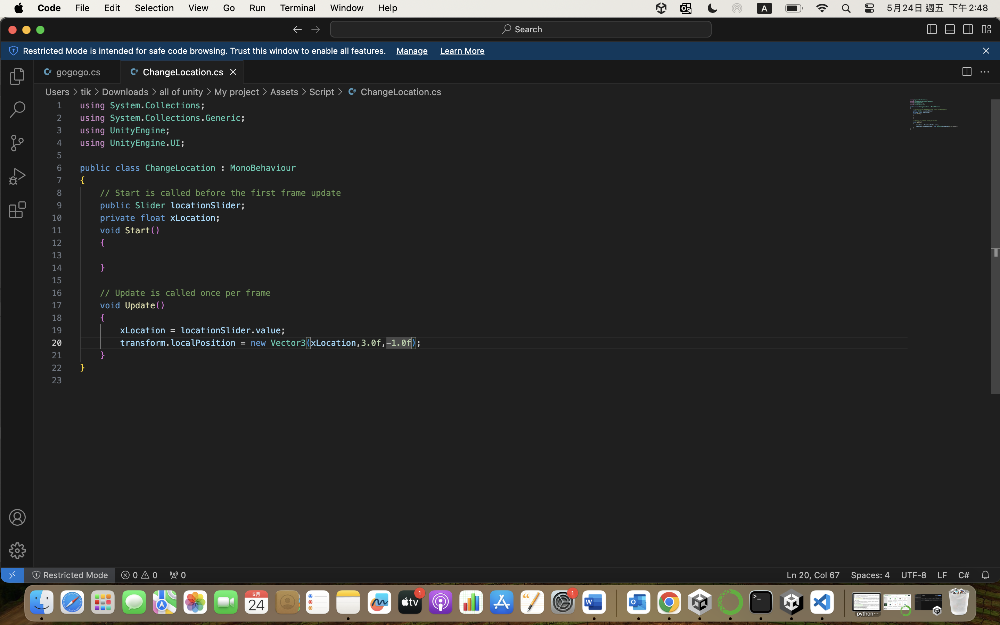

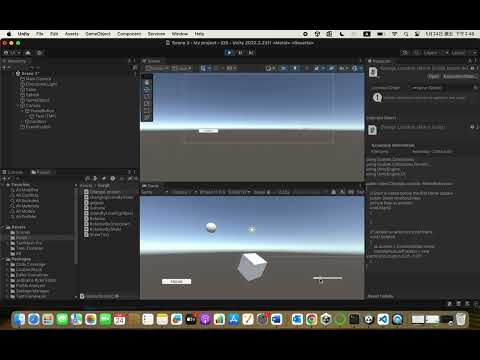

In [2]:
from IPython.display import YouTubeVideo

video_id = 'knjYEyICSqA' ## https://www.youtube.com/watch?v=knjYEyICSqA

YouTubeVideo(video_id)

When we combine "transform.localPosition" (changing location) and "transform.localScale" (changing scale), we can get something like the object is elongated.

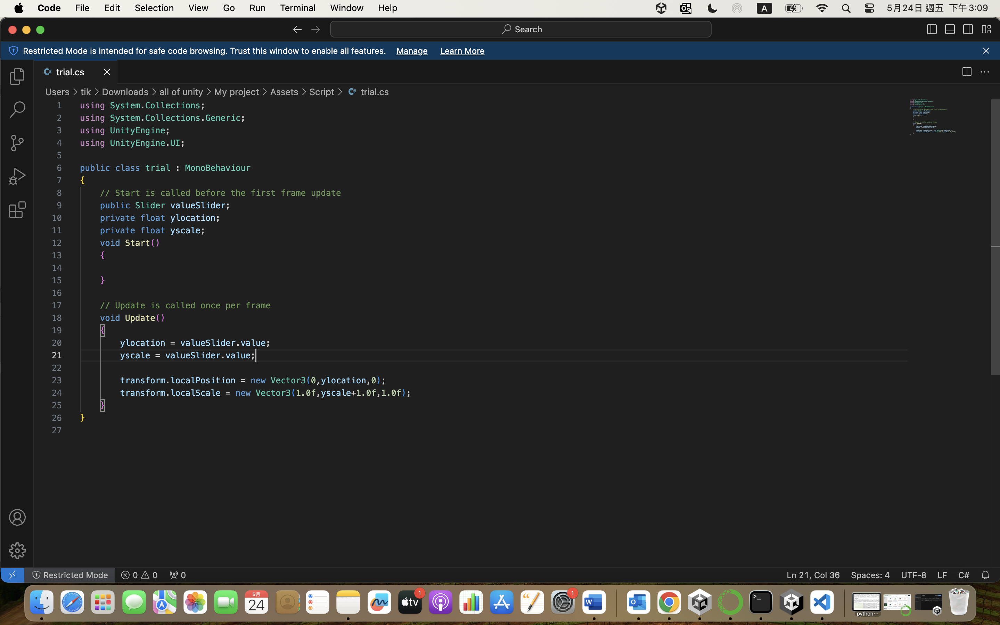

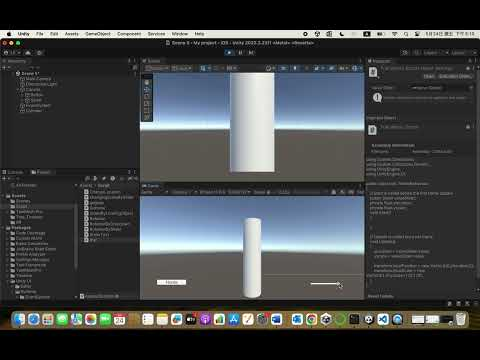

In [1]:
from IPython.display import YouTubeVideo

video_id = 'hHDoLJgsXTM' ## https://www.youtube.com/watch?v=hHDoLJgsXTM

YouTubeVideo(video_id)

Here we try to combine the rotation and math function in order to control slider of radius to change the angle of the object.

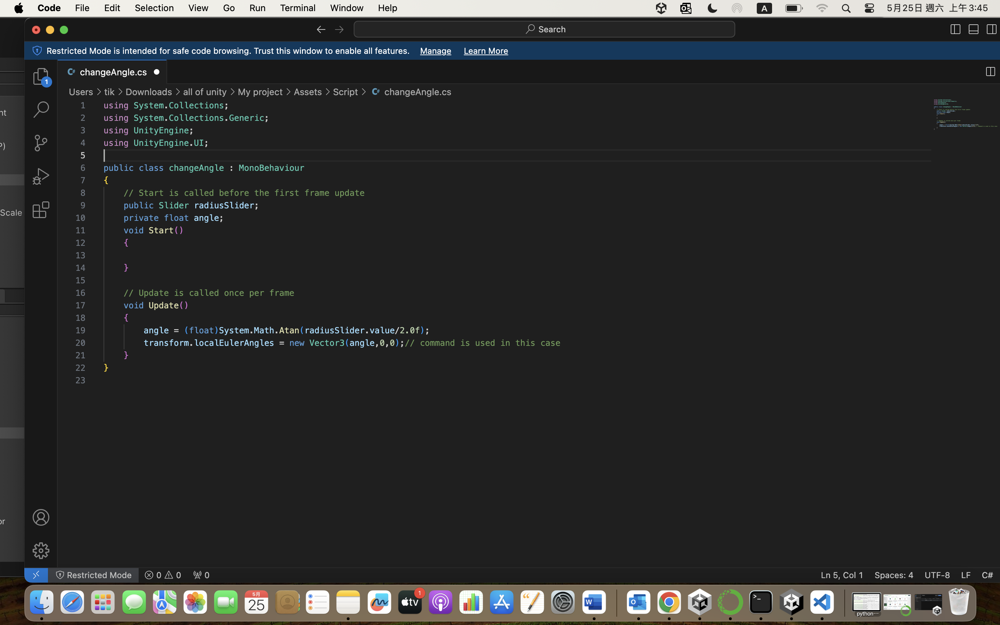

We can set the object being active or not by using button


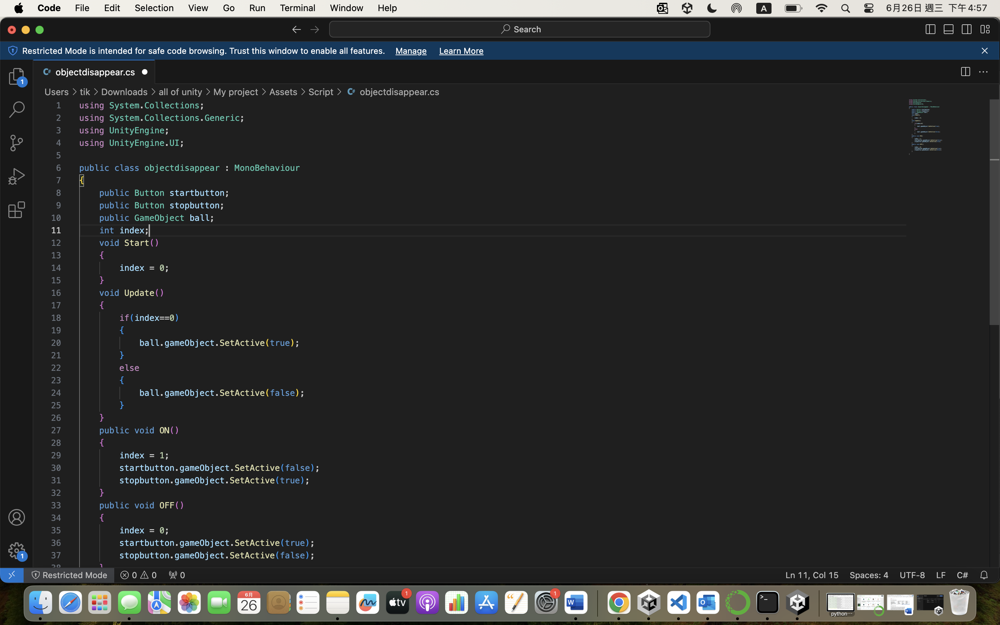


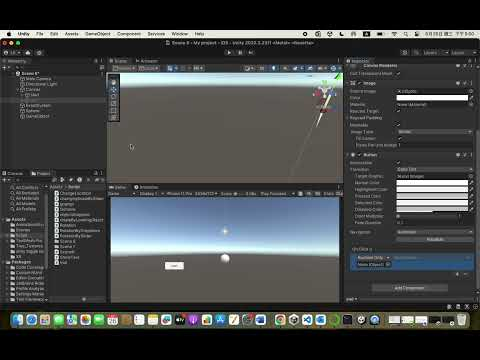

In [1]:
from IPython.display import YouTubeVideo

video_id = 'pRl86Rox3hg' ## https://www.youtube.com/watch?v=pRl86Rox3hg

YouTubeVideo(video_id)

We can get the value of the object

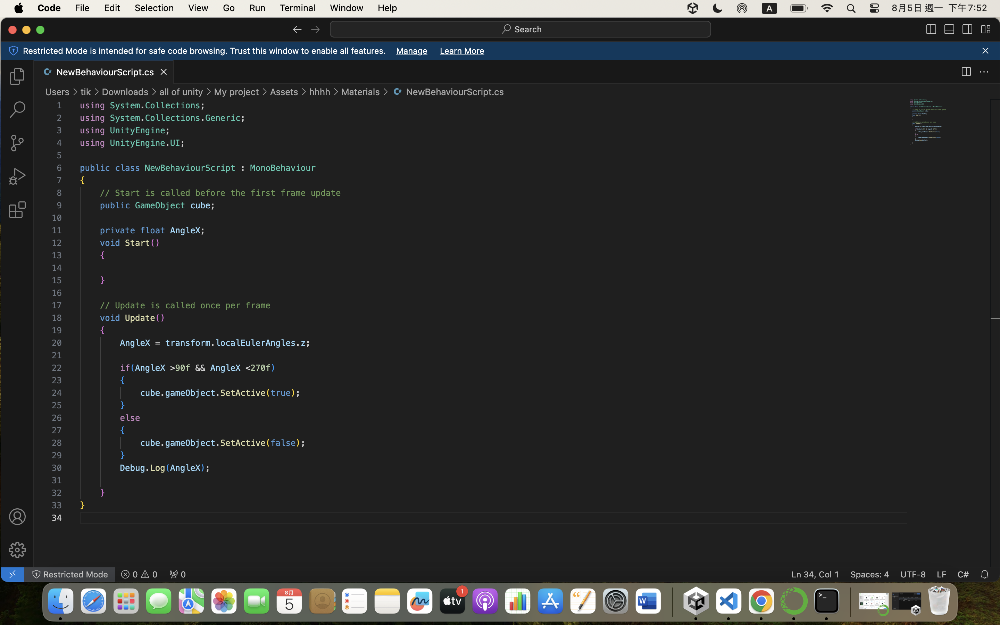

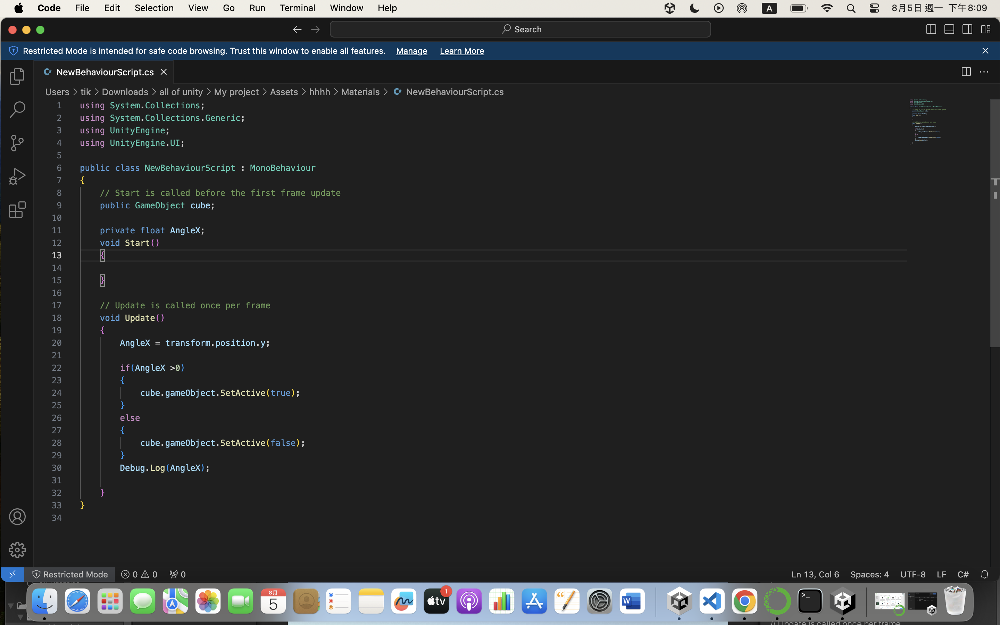


We can calculate the distance between two object.

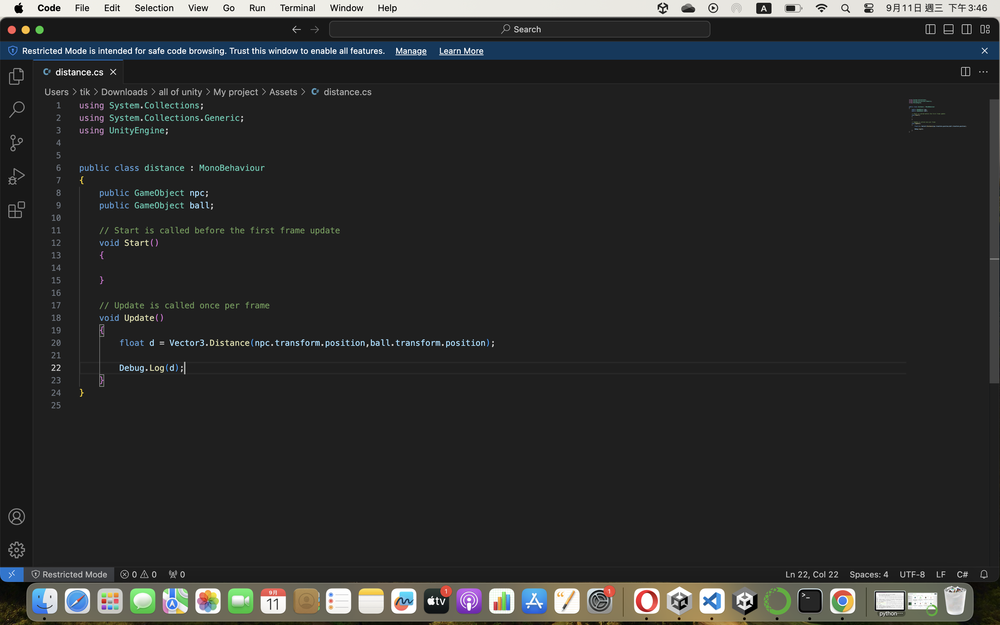


we can move the character by "wasd" and mouse in 3d

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;

[RequireComponent(typeof(CharacterController))]  

public class PlayerMovement : MonoBehaviour 

{  

    public Camera playerCamera;
    public float walkSpeed = 6f;
    public float runSpeed = 12f;
    public float jumpPower = 7f;
    public float gravity = 10f;
    public float lookSpeed = 2f;
    public float lookXLimit = 45f;
    public float defaultHeight = 2f;
    public float crouchHeight = 1f;
    public float crouchSpeed = 3f;

    private Vector3 moveDirection = Vector3.zero;
    private float rotationX = 0;
    private CharacterController characterController;

    private bool canMove = true;

    void Start()
    {
        characterController = GetComponent<CharacterController>();
        Cursor.lockState = CursorLockMode.Locked;
        Cursor.visible = false;
    }

    void Update()
    {
        Vector3 forward = transform.TransformDirection(Vector3.forward);
        Vector3 right = transform.TransformDirection(Vector3.right);

        bool isRunning = Input.GetKey(KeyCode.LeftShift);
        float curSpeedX = canMove ? (isRunning ? runSpeed : walkSpeed) * Input.GetAxis("Vertical") : 0;
        float curSpeedY = canMove ? (isRunning ? runSpeed : walkSpeed) * Input.GetAxis("Horizontal") : 0;
        float movementDirectionY = moveDirection.y;
        moveDirection = (forward * curSpeedX) + (right * curSpeedY);

        if (Input.GetButton("Jump") && canMove && characterController.isGrounded)
        {
            moveDirection.y = jumpPower;
        }
        else
        {
            moveDirection.y = movementDirectionY;
        }

        if (!characterController.isGrounded)
        {
            moveDirection.y -= gravity * Time.deltaTime;
        }

        if (Input.GetKey(KeyCode.R) && canMove)
        {
            characterController.height = crouchHeight;
            walkSpeed = crouchSpeed;
            runSpeed = crouchSpeed;

        }
        else
        {
            characterController.height = defaultHeight;
            walkSpeed = 6f;
            runSpeed = 12f;
        }

        characterController.Move(moveDirection * Time.deltaTime);

        if (canMove)
        {
            rotationX += -Input.GetAxis("Mouse Y") * lookSpeed;
            rotationX = Mathf.Clamp(rotationX, -lookXLimit, lookXLimit);
            playerCamera.transform.localRotation = Quaternion.Euler(rotationX, 0, 0);
            transform.rotation *= Quaternion.Euler(0, Input.GetAxis("Mouse X") * lookSpeed, 0);
        }
    }
}

// 

we can make a dialogue system by writing serval sripts

Before that, make sure that "Input.System" package is installed, TMP_Text as well.

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  

using TMPro;  

public class DialogueController : MonoBehaviour  

{  
    // [SerializeField] private TextMeshProUGUI NPCNameText;  
    
    [SerializeField] private TextMeshProUGUI NPCDialogueText;  

    private Queue <string> paragraphs = new Queue<string>();

    private bool conversationEnded;

    private string p;

    public void DisplayNextParagraph(DialogueText dialogueText)
    {
        if(paragraphs.Count == 0)
        {
            if(!conversationEnded)
            {
                StartConversation(dialogueText);
            }
            else
            {
                EndConversation(); 
                return;
            }
        }

        p = paragraphs.Dequeue();

        NPCDialogueText.text = p;

        if(paragraphs.Count == 0)
        {
            conversationEnded = true;
        }

    }
    private void StartConversation(DialogueText dialogueText)
    {
        if(!gameObject.activeSelf)
        
        
        {
            gameObject.SetActive(true);
        }

        // NPCNameText.text = dialogueText.speakerName;

        for(int i = 0; i< dialogueText.paragraphs.Length; i++)
        {
            paragraphs.Enqueue(dialogueText.paragraphs[i]);
        }
    }
    private void EndConversation()
    {
        conversationEnded = false;

        if(gameObject.activeSelf)
        {
            gameObject.SetActive(false);
        }
    }
}



//////////////////////////////////////////////////////////////////////////////////////////////////////////////

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  

public class Wraith : NPC, ITalkable  

{
   
    [SerializeField] private DialogueText dialogueText;
    [SerializeField] private DialogueController dialogueController;

    public override void Interact()
    {
        Talk(dialogueText);
    }
    public void Talk(DialogueText dialogueText)
    {
        dialogueController.DisplayNextParagraph(dialogueText);
    }
}



//////////////////////////////////////////////////////////////////////////////////////////////////////////////

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  

using UnityEngine.InputSystem;  


public abstract class NPC : MonoBehaviour, IInteractable  

{  

    [SerializeField] private SpriteRenderer _interactSprite;

    private Transform _playerTransform;

    private const float INTERACT_DISTANCE = 5f;

    private void Start()
    {
        _playerTransform = GameObject.FindGameObjectWithTag("Player").transform;
    }

    private void Update()
    {
       if(Keyboard.current.eKey.wasPressedThisFrame && IsWithInteractDistance())
    {
        //interact
        Interact();
    }
    
        if(_interactSprite.gameObject.activeSelf && !IsWithInteractDistance())
        {
            _interactSprite.gameObject.SetActive(false);
        }
        else if(!_interactSprite.gameObject.activeSelf && IsWithInteractDistance())
        {
            _interactSprite.gameObject.SetActive(true);
           
        }
    

    }
    public abstract void Interact();

    private bool IsWithInteractDistance()
    {
        if(Vector3.Distance(_playerTransform.position,transform.position)<2f)
        {
            return true;
        }
        else
        {
            return false;
        }
    }
    
}


//////////////////////////////////////////////////////////////////////////////////////////////////////////////

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  


public interface ITalkable  

{

    public void Talk(DialogueText dialogueText);  
   
}


using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  

[CreateAssetMenu(menuName = "Dialogue/New Dialogue")]

public class DialogueText : ScriptableObject
{  

    // Start is called before the first frame update  
    
    // public string speakerName;  
    
    [TextArea(5,10)]
    public string [] paragraphs;
   
}


using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  

public interface IInteractable   

{  

    // Start is called before the first frame update  
    
    public void Interact();
    
}



//////////////////////////////////////////////////////////////////////////////////////////////////////////////

We can make a portal in unity

using System.Collections; 

using System.Collections.Generic; 

using UnityEngine;  


public class PortalCamera : MonoBehaviour {

	public Transform playerCamera;
	public Transform portal;
	public Transform otherPortal;
	
	// Update is called once per frame
	void Update () {
		Vector3 playerOffsetFromPortal = playerCamera.position - otherPortal.position;

		transform.position = portal.position + playerOffsetFromPortal;

		float angularDifferenceBetweenPortalRotations = Quaternion.Angle(portal.rotation, otherPortal.rotation);

		Quaternion portalRotationalDifference = Quaternion.AngleAxis(angularDifferenceBetweenPortalRotations, Vector3.up);

		Vector3 newCameraDirection = portalRotationalDifference * playerCamera.forward;
		
		transform.rotation = Quaternion.LookRotation(newCameraDirection, Vector3.up);
	}
}

using System.Collections;  

using System.Collections.Generic;  

using UnityEngine;  


public class PortalTextureSetup : MonoBehaviour {  


	public Camera cameraA;
	public Camera cameraB;

	public Material cameraMatA;
	public Material cameraMatB;

	// Use this for initialization
	void Start () {
		if (cameraA.targetTexture != null)
		{
			cameraA.targetTexture.Release();
		}
		cameraA.targetTexture = new RenderTexture(Screen.width, Screen.height, 24);
		cameraMatA.mainTexture = cameraA.targetTexture;

		if (cameraB.targetTexture != null)
		{
			cameraB.targetTexture.Release();
		}
		cameraB.targetTexture = new RenderTexture(Screen.width, Screen.height, 24);
		cameraMatB.mainTexture = cameraB.targetTexture;
	}
	
}

using System.Collections;
using System.Collections.Generic;
using UnityEngine;
using UnityEngine.UI;

public class PortalTeleporter : MonoBehaviour {

	public Transform player;
    public Transform destination;
    public GameObject playerg;

	private bool playerIsOverlapping = false;

	// Update is called once per frame
	void Update () 
    {
		if (playerIsOverlapping)
		{

                Vector3 portalToPlayer = player.position - transform.position;

			    float dotProduct = Vector3.Dot(transform.up, portalToPlayer);

                if (dotProduct < 0f)
			{
				// Teleport him!
				float rotationDiff = -Quaternion.Angle(transform.rotation, destination.rotation);
				rotationDiff += 180;
				player.Rotate(Vector3.up, rotationDiff);

				playerg.SetActive(false);
                player.position = destination.position;
                playerg.SetActive(true);

				playerIsOverlapping = false;
			}

				playerIsOverlapping = false;
			
		}
	}

	void OnTriggerEnter (Collider other)
	{
		if (other.tag == "Player")
		{
			playerIsOverlapping = true;
		}
	}

	void OnTriggerExit (Collider other)
	{
		if (other.tag == "Player")
		{
			playerIsOverlapping = false;
		}
	}
}

For the Rigid body system, there are serval cases of it

In [ ]:
import cv2
import mediapipe as mp
from cvzone.HandTrackingModule import HandDetector
import socket

width, height = 1280, 720
cap = cv2.VideoCapture(0)
cap.set(3, width)  # Set width
cap.set(4, height)   # Set height (optional, but recommended to set both)

detector = HandDetector(maxHands=2, detectionCon=0.8)  # Fixed typo

sock = socket.socket(socket.AF_INET,socket.SOCK_DGRAM)
serverAddressPort = ("127.0.0.1",5052)

while True:
    success, img = cap.read()
    hands, img = detector.findHands(img)
    data = []

    if hands:
        hand = hands[0]
        lmList = hand['lmList']
        #print(hands)
        #print(lmList)
        #print("\n")
        for lm in lmList:
            data.extend([lm[0],height-lm[1],lm[2]])
        #print(data)
        #print("\n")
        sock.sendto(str.encode(str(data)),serverAddressPort)
    img = cv2.resize(img,(0,0),None, 0.5, 0.5)
    cv2.imshow("image", img)
    cv2.waitKey(1)

I0000 00:00:1750751512.854283 3480066 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M1
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
W0000 00:00:1750751512.877161 3495058 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750751512.884882 3495058 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750751520.900070 3495056 landmark_projection_calculator.cc:186] Using NORM_RECT without IMAGE_DIMENSIONS is only supported for the square ROI. Provide IMAGE_DIMENSIONS or use PROJECTION_MATRIX.


In [1]:
import cv2
import numpy as np
from cvzone import HandTrackingModule
from cvzone.HandTrackingModule import HandDetector

width, height = 1280, 720
cap = cv2.VideoCapture(0)
cap.set(3, width)  # Set width
cap.set(4, height)  # Set height

detector = HandDetector(maxHands=2, detectionCon=0.8)

while True:
    success, img = cap.read()
    if not success:
        print("Failed to read frame")
        break
    
    hands, img = detector.findHands(img)
    
    if hands:
        for hand in hands:
            # Extract hand data
            landmarks = hand["lmList"]  # List of 21 landmarks (x, y, z coordinates)
            bbox = hand["bbox"]  # Bounding box (x, y, w, h)
            handType = hand["type"]  # 'Left' or 'Right'
            center = hand["center"]  # Center of the hand (x, y)
            
            # Print the data for each hand
            print(f"Hand: {handType}")
            print(f"Bounding Box: {bbox}")
            print(f"Center: {center}")
            print("Landmarks:")
            for i, lm in enumerate(landmarks):
                print(f"  Landmark {i}: {lm}")
            print("-" * 50)
    
    # Resize image for display
    img = cv2.resize(img, (0, 0), None, 0.5, 0.5)
    cv2.imshow("image", img)
    
    # Break loop on 'q' press
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
cv2.destroyAllWindows()

I0000 00:00:1750754464.033137 3497146 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M1
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
W0000 00:00:1750754464.051849 3522871 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750754464.058619 3522871 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750754464.968676 3522874 landmark_projection_calculator.cc:186] Using NORM_RECT without IMAGE_DIMENSIONS is only supported for the square ROI. Provide IMAGE_DIMENSIONS or use PROJECTION_MATRIX.


Hand: Left
Bounding Box: (771, 263, 217, 163)
Center: (879, 344)
Landmarks:
  Landmark 0: [988, 410, 0]
  Landmark 1: [940, 426, -10]
  Landmark 2: [891, 417, -13]
  Landmark 3: [862, 393, -18]
  Landmark 4: [837, 379, -23]
  Landmark 5: [874, 353, -2]
  Landmark 6: [828, 334, -16]
  Landmark 7: [798, 328, -29]
  Landmark 8: [771, 325, -37]
  Landmark 9: [893, 328, -8]
  Landmark 10: [849, 292, -20]
  Landmark 11: [818, 274, -31]
  Landmark 12: [793, 263, -39]
  Landmark 13: [919, 311, -18]
  Landmark 14: [885, 279, -34]
  Landmark 15: [867, 282, -43]
  Landmark 16: [854, 291, -47]
  Landmark 17: [951, 300, -28]
  Landmark 18: [920, 281, -42]
  Landmark 19: [903, 285, -46]
  Landmark 20: [893, 295, -47]
--------------------------------------------------
Hand: Right
Bounding Box: (507, 211, 201, 162)
Center: (607, 292)
Landmarks:
  Landmark 0: [507, 356, 0]
  Landmark 1: [561, 373, -7]
  Landmark 2: [612, 364, -8]
  Landmark 3: [648, 346, -11]
  Landmark 4: [670, 326, -14]
  Landmark 5:

In [ ]:
import socket
serverAddressPort = ("127.0.0.1",5052)
